## EVI analysis with Conflict Data Overlay

The maps overlay ACLED conflict event clusters on top of the EVI percent change data at the Admin1 level (state boundaries) for Sudan, showing variations between 2023 and 2024 compared to the 2018-2022 baseline. The EVI changes are color-coded, with green indicating improved vegetation and red showing declines in vegetation health.

### Data and Methodology

The following datasets are utilized in this analysis for calculating and mapping crop productivity over the past years:

1. **MODIS EVI (Enhanced Vegetation Index) Data**:
   - **Source**: NASA's Moderate Resolution Imaging Spectroradiometer [MODIS](https://modis.gsfc.nasa.gov/data/) on the Terra and Aqua satellites.
   - **Description**: The dataset provides the Enhanced Vegetation Index (EVI), which is an optimized vegetation index designed to improve sensitivity in regions with dense vegetation while minimizing soil background influences.
   - **Spatial Resolution**: 500 meters.
   - **Temporal Coverage**: Data is collected every 16 days. This analysis focuses on yearly aggregated EVI values from 2018 to 2024.
   - **Use Case**: The EVI data is used to identify productive cropland areas by applying thresholds indicative of healthy vegetation.

2.**DEA Cropland Mask**:
   - **Source:** DEA Croplands - Digital Earth Africa
   - **Description:** The [DEA Croplands dataset](https://gee-community-catalog.org/projects/dea_croplands/) is a high-resolution crop mask developed by Digital Earth Africa to identify and monitor cropland areas across the African continent. It leverages satellite data from Landsat and Sentinel-2, using advanced classification techniques to differentiate between cropland and non-cropland regions. The dataset is updated regularly to account for seasonal variations and changes in agricultural land use.
   - **Use Case:** This crop mask is used for agricultural monitoring, land use planning, food security assessments, and environmental management. It provides valuable insights into the distribution and extent of cropland, aiding decision-making processes related to sustainable agricultural practices and resource management in Africa.

3. **Administrative Boundaries (HDX)**:
   - **Source**: Humanitarian Data Exchange [HDX](https://data.humdata.org/).
   - **Description**: Geographic boundaries used for spatial aggregation and administrative analysis, such as calculating productivity metrics by region (e.g., governorate or district).
   - **Use Case**: The administrative boundaries are used to aggregate EVI statistics by region and facilitate reporting at various administrative levels.

4. **ACLED Conflict Data**:
   - **Source**: [ACLED](https://acleddata.com/data/) provides real-time data on conflict events worldwide.
   - **Description**: Conflict data was sourced from the ACLED database, which provides detailed records of events such as battles, protests, and other violent activities, including attributes like event type, date, and number of fatalities.The dataset was loaded as a CSV and converted to a GeoDataFrame (acled_gdf), with geometries representing the event locations.
   -**Use Case**: Used for conflict monitoring, risk assessment, and informing humanitarian policies.


**Visualization Insights**
    
1. **EVI Changes**:The maps highlight regions with significant changes in vegetation health, allowing for comparison across different states.
    Areas with declining EVI may indicate agricultural stress or drought conditions, which can impact livelihoods and exacerbate social tensions.

2. **Conflict Event Clusters**: Conflict events are displayed using clustered markers, with size and color indicating the frequency and severity of events (e.g., battles, protests, fatalities).

    - The overlay allows for the identification of regions where both vegetation stress and high conflict activity coincide, suggesting potential hotspots where environmental factors may be linked to instability.


In [1]:
import ee
ee.Authenticate()
ee.Initialize()

In [2]:
import sys
phenolopy_module_path = 'C:/Users/ishaa/OneDrive/Desktop/DataLab/Sudan/sudan-poverty-monitoring/Phenolopy/scripts'
gee_zonal_module_path = r'C:/Users/ishaa/OneDrive/Desktop/DataLab/Sudan/sudan-poverty-monitoring/GEE_Zonal/src/gee_zonal'
sys.path.append(phenolopy_module_path)
sys.path.append(gee_zonal_module_path)

# Now, import the zonal_stats module
import zonalstats
import phenolopy
import gee_helpers


In [3]:
import os
from os.path import join, expanduser

#sys.path.append(join(expanduser("~"), "Repos", "GEE_Zonal", "src"))

# Data
import geopandas as gpd
import pandas as pd
import numpy as np

## Earth Engine APIs
import ee
import geemap
import gee_zonal
from gee_helpers import gpd_to_gee
from zonalstats import ZonalStats
#from gee_zonal import gpd_to_gee
from geemap.conversion import *
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import xarray as xr
from tqdm.notebook import tqdm
from dask.distributed import Client, LocalCluster
import requests
import rasterio
from rasterio.mask import mask

from plotnine import *
from mizani.breaks import date_breaks
from mizani.formatters import date_format

import json
import folium

#sys.path.append(join(expanduser("~"), "Repos", "phenolopy", "scripts"))
#import phenolopy

sys.path.append(join(expanduser("~"), "Repos", "GOSTrocks", "src"))

In [4]:
# local directory path
base_path = "C:\\Users\\ishaa\\OneDrive\\Desktop\\DataLab\\Sudan\\sudan-poverty-monitoring"

In [5]:
#loading boundaries 
adm0_path = os.path.join(base_path,'data','boundaries_hdx','sdn_admbnda_adm0_cbs_nic_ssa_20200831.shp')
sdn_adm0 = gpd.read_file(adm0_path)
sdn_adm0.to_file("sudan_boundary.geojson", driver="GeoJSON")
with open("sudan_boundary.geojson") as f:
    sdn_geojson = json.load(f)
sudan_geometry = ee.Geometry(sdn_geojson['features'][0]['geometry'])


adm1_path = os.path.join(base_path,'data','state_poly_mar20','State_Poly_Mar20.shp')
sdn_adm1 = gpd.read_file(adm1_path)
sdn_adm1.to_file("sudan_boundary1.geojson", driver="GeoJSON")
with open("sudan_boundary1.geojson") as f:
    sdn_geojson_adm1 = json.load(f)
sdn_adm1_geometry = ee.Geometry(sdn_geojson_adm1['features'][0]['geometry'])

In [6]:
#MODIS Data for EVI
start_period = ee.Date("2018-01-01")
end_period = ee.Date("2024-08-31")

terra = (
    ee.ImageCollection("MODIS/061/MOD13Q1")
    .select(["EVI", "SummaryQA", "DetailedQA"])
    .filterDate(start_period, end_period)
)
aqua = (
    ee.ImageCollection("MODIS/061/MYD13Q1")
    .select(["EVI", "SummaryQA", "DetailedQA"])
    .filterDate(start_period, end_period)
)

modis = terra.select("EVI").merge(aqua.select("EVI"))
modis = modis.sort("system:time_start")

#----------------------BITWISE MASKING---------------------------------------
def bitwiseExtract(value, fromBit, toBit=None):
    if toBit == None:
        toBit = fromBit
    maskSize = ee.Number(1).add(toBit).subtract(fromBit)
    mask = ee.Number(1).leftShift(maskSize).subtract(1)
    return value.rightShift(fromBit).bitwiseAnd(mask)


# Applying the SummaryQA  and DetailedQA
def modisQA_mask(image):
    sqa = image.select("SummaryQA")
    dqa = image.select("DetailedQA")
    viQualityFlagsS = bitwiseExtract(sqa, 0, 1)
    viQualityFlagsD = bitwiseExtract(dqa, 0, 1)
    # viUsefulnessFlagsD = bitwiseExtract(dqa, 2, 5)
    viSnowIceFlagsD = bitwiseExtract(dqa, 14)
    viShadowFlagsD = bitwiseExtract(dqa, 15)
    # Good data, use with confidence
    mask = (
        viQualityFlagsS.eq(0)
        .And(viQualityFlagsD.eq(0))
        .And(viQualityFlagsS.eq(1))
        .And(viQualityFlagsD.eq(1))
        .And(viSnowIceFlagsD)
        .eq(0)
    )
    # .And(viShadowFlagsD).eq(0); # No shadow
    return image.updateMask(mask)


mod13q1_QC = terra.map(modisQA_mask)
myd13q1_QC = aqua.map(modisQA_mask)

mxd13q1_cleaned = mod13q1_QC.select("EVI").merge(myd13q1_QC.select("EVI"))
mxd13q1_cleaned_sorted = mxd13q1_cleaned.sort("system:time_start")

bool_dict = {
    "0": "ocean",
    "1": "non_crop",
    "2": "crop_irrigated",
    "3": "crop_rainfed",
}

#Applying DEA Cropmask
dea = ee.ImageCollection(
    "projects/sat-io/open-datasets/DEAF/CROPLAND-EXTENT/mask"
).mosaic()
crop_data_dea = dea.select("b1").rename("crop").clip(sudan_geometry)
crop_data_viz_dea = crop_data_dea.mask(crop_data_dea.gt(0))


scale_factor = 0.0001

# apply cropland mask to imageCollection
def cropmask(img):
    return img.updateMask(crop_data_dea).clip(sudan_geometry)  # .multiply(scale_factor) # unmask(-1)


mxd13q1 = mxd13q1_cleaned_sorted.map(cropmask)

In [7]:
growing_season = ee.Filter.calendarRange(6, 11, 'month')

# Calculate mean EVI for 2018-2022 growing seasons
gs_evi_5yr_avg = mxd13q1.filterDate('2018-01-01', '2022-12-31').filter(growing_season).mean().clip(sudan_geometry)
#gs_evi_2018_2022_std = mxd13q1.filterDate('2018-01-01', '2022-12-31').filter(growing_season).reduce(ee.Reducer.stdDev())

# Calculate mean EVI for the 2023 growing season
gs_evi_2023 = mxd13q1.filterDate('2023-01-01', '2023-12-31').filter(growing_season).mean().clip(sudan_geometry)

# Calculate mean EVI for the 2023 growing season
gs_evi_2024 = mxd13q1.filterDate('2024-01-01', '2024-12-31').filter(growing_season).mean().clip(sudan_geometry)

#calculate diff in EVI
evi_diff_2023 = gs_evi_2023.subtract(gs_evi_5yr_avg).rename('EVI_diff_2023')
evi_diff_2024 = gs_evi_2024.subtract(gs_evi_5yr_avg).rename('EVI_diff_2024')


In [8]:
# Load the ACLED data (make sure to have latitude and longitude columns)
# Load the ACLED conflict data
acled_data_path = os.path.join(base_path,'data','2023-04-01-2024-10-24-Northern_Africa-Sudan_acled.csv')
acled_data = pd.read_csv(acled_data_path, parse_dates=['event_date'])
acled_gdf = gpd.GeoDataFrame(acled_data, geometry=gpd.points_from_xy(acled_data.longitude, acled_data.latitude))

# Filter for events in 2023 and within the Sudan region
acled_data_2023 = acled_data[(acled_data['event_date'].dt.year == 2023) & 
                             (acled_data['country'] == 'Sudan')]

acled_data_2024 = acled_data[(acled_data['event_date'].dt.year == 2024) & 
                             (acled_data['country'] == 'Sudan')]

acled_2023_gdf = gpd.GeoDataFrame(
    acled_data_2023, 
    geometry=gpd.points_from_xy(acled_data_2023.longitude, acled_data_2023.latitude),
    crs="EPSG:4326"  # Set the appropriate CRS, e.g., WGS84
)

# Ensure both GeoDataFrames are in the same CRS
acled_2023_gdf = acled_2023_gdf.to_crs(sdn_adm1.crs)

acled_2024_gdf = gpd.GeoDataFrame(
    acled_data_2024, 
    geometry=gpd.points_from_xy(acled_data_2024.longitude, acled_data_2024.latitude),
    crs="EPSG:4326"  # Set the appropriate CRS, e.g., WGS84
)

# Ensure both GeoDataFrames are in the same CRS
acled_2024_gdf = acled_2024_gdf.to_crs(sdn_adm1.crs)

#### Acled Overlay on EVI Change: 2023

![Acled overlay EVI for 2023](../../docs/images/agriculture/EVI_Acled_overlay_2023_2.png)

In [ ]:
import folium
import ee
import geetools
#import geetools.ui
from folium import plugins
from folium.plugins import MarkerCluster

roi = ee.FeatureCollection("FAO/GAUL/2015/level0").filter(ee.Filter.eq('ADM0_NAME', 'Sudan'))
aoi = roi.geometry()

#Function to visualize 'evi' band using folium from red to green
def visualize_evi(image, region, acled_gdf):
    # Define visualization parameters
    vis_params = {
    'min': -1000,  # Adjust these based on your EVI range
    'max': 1000,
    'palette': ['red', 'yellow', 'green']  # Colors for EVI drop/rise
}

    # Get URL of the image
    image_url = image.visualize(**vis_params).getMapId()['tile_fetcher'].url_format

    # Create folium map centered on the region
    map_center = region.centroid().getInfo()['coordinates']
    fmap = folium.Map(location=[map_center[1], map_center[0]], zoom_start=5)

    # Add image to folium map
    folium.raster_layers.TileLayer(
        tiles=image_url,
        attr="Google Earth Engine",
        overlay=True,
        name='EVI',
        control=True
    ).add_to(fmap)

    # Add GeoJson for Admin1 boundaries with tooltips to display the region name and percent change
    folium.GeoJson(
        sdn_adm1,
        style_function=lambda feature: {
            'fillColor': 'gray',  # Make sure it doesn't interfere with the Choropleth
            'color': 'black',
            'weight': 1,
            'dashArray': '5, 5'
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['State_En'],
            aliases=['Admin1 Region:'],
            localize=True
        )
    ).add_to(fmap)

    # Add Admin1 region labels using folium.DivIcon
    for idx, row in sdn_adm1.iterrows():
        # Get the center of the geometry for labeling
        centroid = row['geometry'].centroid
        region_name = row['State_En']
        
        # Add the region name as a label to the map
        folium.map.Marker(
            location=[centroid.y, centroid.x],
            icon=folium.DivIcon(
                icon_size=(150, 36),
                icon_anchor=(0, 0),
                html=f'<div style="font-size: 10pt; color: black; font-weight: bold;">{region_name}</div>',
            )
        ).add_to(fmap)

    # Add MarkerCluster for ACLED data
    marker_cluster = MarkerCluster().add_to(fmap)

    # Customize marker styling based on event type or severity
    for _, row in acled_gdf.iterrows():
        event_type = row['event_type']
        fatalities = row.get('fatalities', 0)

        # Set marker color based on event type
        if event_type == "Battle":
            color = "red"
        elif event_type == "Protest":
            color = "blue"
        else:
            color = "orange"

        # Marker size based on fatalities (if available)
        size = 3 + fatalities * 0.5

        # Add markers to the cluster
        folium.CircleMarker(
            location=(row.geometry.y, row.geometry.x),
            radius=size,
            color=color,
            fill=True,
            fill_opacity=0.6,
            popup=f"Event: {event_type}<br>Fatalities: {fatalities}<br>Location: {row['location']}",
        ).add_to(marker_cluster)

        # Add layer control
        folium.LayerControl().add_to(fmap)


    return fmap

#Example usage
region = sudan_geometry

image = evi_diff_2023

#Visualize
fmap = visualize_evi(image, region ,acled_2023_gdf)

# Add colorbar to the map (it will appear at the bottom left by default)
colormap.add_to(fmap)
#fmap.save("evi_visualization.html")#

fmap

In [ ]:
'''import folium
import ee
import geopandas as gpd
from folium.plugins import MarkerCluster
import branca.colormap as cm

roi = ee.FeatureCollection("FAO/GAUL/2015/level0").filter(ee.Filter.eq('ADM0_NAME', 'Sudan'))
aoi = roi.geometry()

# Function to visualize 'evi' band using folium from red to green
def visualize_evi(image, region, acled_gdf):
    # Define visualization parameters
    vis_params = {
        'min': -1000,  # Adjust these based on your EVI range
        'max': 1000,
        'palette': ['red', 'yellow', 'green']  # Colors for EVI drop/rise
    }

    # Get URL of the image
    image_url = image.visualize(**vis_params).getMapId()['tile_fetcher'].url_format

    # Create folium map centered on the region
    map_center = region.centroid().getInfo()['coordinates']
    fmap = folium.Map(location=[map_center[1], map_center[0]], zoom_start=5)

    # Add image to folium map
    folium.raster_layers.TileLayer(
        tiles=image_url,
        attr="Google Earth Engine",
        overlay=True,
        name='EVI',
        control=True
    ).add_to(fmap)

    # Add GeoJson for Admin1 boundaries with tooltips
    folium.GeoJson(
        sdn_adm1,
        style_function=lambda feature: {
            'fillColor': 'gray',
            'color': 'black',
            'weight': 1,
            'dashArray': '5, 5'
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['State_En'],
            aliases=['Admin1 Region:'],
            localize=True
        )
    ).add_to(fmap)

    # Add Admin1 region labels using folium.DivIcon
    for idx, row in sdn_adm1.iterrows():
        centroid = row['geometry'].centroid
        region_name = row['State_En']
        folium.Marker(
            location=[centroid.y, centroid.x],
            icon=folium.DivIcon(
                icon_size=(150, 36),
                icon_anchor=(0, 0),
                html=f'<div style="font-size: 10pt; color: black; font-weight: bold;">{region_name}</div>',
            )
        ).add_to(fmap)

    # Add MarkerCluster for ACLED data
    marker_cluster = MarkerCluster().add_to(fmap)

    for _, row in acled_gdf.iterrows():
        event_type = row['event_type']
        fatalities = row.get('fatalities', 0)

        # Set marker color based on event type
        color = {
            "Battle": "red",
            "Protest": "blue"
        }.get(event_type, "orange")

        # Marker size based on fatalities
        size = 3 + fatalities * 0.5

        folium.CircleMarker(
            location=(row.geometry.y, row.geometry.x),
            radius=size,
            color=color,
            fill=True,
            fill_opacity=0.6,
            popup=f"Event: {event_type}<br>Fatalities: {fatalities}<br>Location: {row['location']}",
        ).add_to(marker_cluster)

    # Add layer control
    folium.LayerControl().add_to(fmap)

    # Add color bar
    colormap = cm.LinearColormap(
        colors=['red', 'yellow', 'green'],
        vmin=-1000, vmax=1000
    ).to_step(index=[-1000, -500, 0, 500, 1000])
    colormap.caption = 'EVI Difference (2023) vs (2018-2022)'
    fmap.add_child(colormap)

    return fmap

# Example usage
region = aoi
image = evi_diff_2023  # Replace with your EVI difference image
#acled_2023_gdf = gpd.read_file('path_to_acled_data.geojson')  # Replace with your ACLED GeoDataFrame
#sdn_adm1 = gpd.read_file('path_to_admin1_geojson.geojson')  # Replace with your Admin1 GeoJSON

# Visualize
fmap = visualize_evi(image, region, acled_2023_gdf)

# Save the map to an HTML file
#fmap.save("evi_visualization.html")

fmap'''

#### Acled Overlay on EVI change: 2024

![Acled overlay EVI for 2024](../../docs/images/agriculture/EVI_Acled_overlay_2024_2.png)

In [10]:
import folium
import ee
import geetools
#import geetools.ui
from folium import plugins
from folium.plugins import MarkerCluster

roi = ee.FeatureCollection("FAO/GAUL/2015/level0").filter(ee.Filter.eq('ADM0_NAME', 'Sudan'))
aoi = roi.geometry()

#Function to visualize 'evi' band using folium from red to green
def visualize_evi(image, region, acled_gdf):
    # Define visualization parameters
    vis_params = {
    'min': -1000,  # Adjust these based on your EVI range
    'max': 1000,
    'palette': ['red', 'yellow', 'green']  # Colors for EVI drop/rise
}

    # Get URL of the image
    image_url = image.visualize(**vis_params).getMapId()['tile_fetcher'].url_format

    # Create folium map centered on the region
    map_center = region.centroid().getInfo()['coordinates']
    fmap = folium.Map(location=[map_center[1], map_center[0]], zoom_start=5)

    # Add image to folium map
    folium.raster_layers.TileLayer(
        tiles=image_url,
        attr="Google Earth Engine",
        overlay=True,
        name='EVI',
        control=True
    ).add_to(fmap)

    # Add GeoJson for Admin1 boundaries with tooltips to display the region name and percent change
    folium.GeoJson(
        sdn_adm1,
        style_function=lambda feature: {
            'fillColor': 'gray',  # Make sure it doesn't interfere with the Choropleth
            'color': 'black',
            'weight': 1,
            'dashArray': '5, 5'
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['State_En'],
            aliases=['Admin1 Region:'],
            localize=True
        )
    ).add_to(fmap)

    # Add Admin1 region labels using folium.DivIcon
    for idx, row in sdn_adm1.iterrows():
        # Get the center of the geometry for labeling
        centroid = row['geometry'].centroid
        region_name = row['State_En']
        
        # Add the region name as a label to the map
        folium.map.Marker(
            location=[centroid.y, centroid.x],
            icon=folium.DivIcon(
                icon_size=(150, 36),
                icon_anchor=(0, 0),
                html=f'<div style="font-size: 10pt; color: black; font-weight: bold;">{region_name}</div>',
            )
        ).add_to(fmap)

    # Add MarkerCluster for ACLED data
    marker_cluster = MarkerCluster().add_to(fmap)

    # Customize marker styling based on event type or severity
    for _, row in acled_gdf.iterrows():
        event_type = row['event_type']
        fatalities = row.get('fatalities', 0)

        # Set marker color based on event type
        if event_type == "Battle":
            color = "red"
        elif event_type == "Protest":
            color = "blue"
        else:
            color = "orange"

        # Marker size based on fatalities (if available)
        size = 3 + fatalities * 0.5

        # Add markers to the cluster
        folium.CircleMarker(
            location=(row.geometry.y, row.geometry.x),
            radius=size,
            color=color,
            fill=True,
            fill_opacity=0.6,
            popup=f"Event: {event_type}<br>Fatalities: {fatalities}<br>Location: {row['location']}",
        ).add_to(marker_cluster)

        # Add layer control
        folium.LayerControl().add_to(fmap)


    return fmap

#Example usage
region = sudan_geometry

image = evi_diff_2024

#Visualize
fmap = visualize_evi(image, region ,acled_2024_gdf)
#fmap.save("evi_visualization.html")#

fmap

In [ ]:
'''import folium
import ee
import geopandas as gpd
from folium.plugins import MarkerCluster
import branca.colormap as cm

roi = ee.FeatureCollection("FAO/GAUL/2015/level0").filter(ee.Filter.eq('ADM0_NAME', 'Sudan'))
aoi = roi.geometry()

# Function to visualize 'evi' band using folium from red to green
def visualize_evi(image, region, acled_gdf):
    # Define visualization parameters
    vis_params = {
        'min': -1000,  # Adjust these based on your EVI range
        'max': 1000,
        'palette': ['red', 'yellow', 'green']  # Colors for EVI drop/rise
    }

    # Get URL of the image
    image_url = image.visualize(**vis_params).getMapId()['tile_fetcher'].url_format

    # Create folium map centered on the region
    map_center = region.centroid().getInfo()['coordinates']
    fmap = folium.Map(location=[map_center[1], map_center[0]], zoom_start=5)

    # Add image to folium map
    folium.raster_layers.TileLayer(
        tiles=image_url,
        attr="Google Earth Engine",
        overlay=True,
        name='EVI',
        control=True
    ).add_to(fmap)

    # Add GeoJson for Admin1 boundaries with tooltips
    folium.GeoJson(
        sdn_adm1,
        style_function=lambda feature: {
            'fillColor': 'gray',
            'color': 'black',
            'weight': 1,
            'dashArray': '5, 5'
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['State_En'],
            aliases=['Admin1 Region:'],
            localize=True
        )
    ).add_to(fmap)

    # Add Admin1 region labels using folium.DivIcon
    for idx, row in sdn_adm1.iterrows():
        centroid = row['geometry'].centroid
        region_name = row['State_En']
        folium.Marker(
            location=[centroid.y, centroid.x],
            icon=folium.DivIcon(
                icon_size=(150, 36),
                icon_anchor=(0, 0),
                html=f'<div style="font-size: 10pt; color: black; font-weight: bold;">{region_name}</div>',
            )
        ).add_to(fmap)

    # Add MarkerCluster for ACLED data
    marker_cluster = MarkerCluster().add_to(fmap)

    for _, row in acled_gdf.iterrows():
        event_type = row['event_type']
        fatalities = row.get('fatalities', 0)

        # Set marker color based on event type
        color = {
            "Battle": "red",
            "Protest": "blue"
        }.get(event_type, "orange")

        # Marker size based on fatalities
        size = 3 + fatalities * 0.5

        folium.CircleMarker(
            location=(row.geometry.y, row.geometry.x),
            radius=size,
            color=color,
            fill=True,
            fill_opacity=0.6,
            popup=f"Event: {event_type}<br>Fatalities: {fatalities}<br>Location: {row['location']}",
        ).add_to(marker_cluster)

    # Add layer control
    folium.LayerControl().add_to(fmap)

    # Add color bar
    colormap = cm.LinearColormap(
        colors=['red', 'yellow', 'green'],
        vmin=-1000, vmax=1000
    ).to_step(index=[-1000, -500, 0, 500, 1000])
    colormap.caption = 'EVI Difference (2023) vs (2018-2022)'
    fmap.add_child(colormap)

    return fmap

# Example usage
region = aoi
image = evi_diff_2024  # Replace with your EVI difference image
#acled_2023_gdf = gpd.read_file('path_to_acled_data.geojson')  # Replace with your ACLED GeoDataFrame
#sdn_adm1 = gpd.read_file('path_to_admin1_geojson.geojson')  # Replace with your Admin1 GeoJSON

# Visualize
fmap = visualize_evi(image, region, acled_2024_gdf)

# Save the map to an HTML file
#fmap.save("evi_visualization.html")

fmap'''

In [ ]:
'''import folium
import ee
import pandas as pd
import branca.colormap as cm

roi = ee.FeatureCollection("FAO/GAUL/2015/level0").filter(ee.Filter.eq('ADM0_NAME', 'Sudan'))
aoi = roi.geometry()

# Function to visualize 'evi' band and Admin1 fatalities
def visualize_evi_with_fatalities(image, region, acled_gdf,admin1_gdf):
    # Define visualization parameters
    vis_params = {
        'min': -1000,  # Adjust these based on your EVI range
        'max': 1000,
        'palette': ['red', 'yellow', 'green']  # Colors for EVI drop/rise
    }

    # Get URL of the image
    image_url = image.visualize(**vis_params).getMapId()['tile_fetcher'].url_format

    # Create folium map centered on the region
    map_center = region.centroid().getInfo()['coordinates']
    fmap = folium.Map(location=[map_center[1], map_center[0]], zoom_start=5)

    # Add GeoJSON layer for admin1 regions with gray fill and dotted black boundaries
    folium.GeoJson(
        admin1_gdf,
        style_function=lambda feature: {
            'fillColor': 'lightgray',
            'color': 'black',
            'weight': 1.5,
            'dashArray': '5, 5',  # Dotted boundary style
            'fillOpacity': 0.2
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['State_En'],
            aliases=['Region:'],
            localize=True
        )
    ).add_to(fmap)


    # Add image to folium map
    folium.raster_layers.TileLayer(
        tiles=image_url,
        attr="Google Earth Engine",
        overlay=True,
        name='EVI',
        control=True
    ).add_to(fmap)

    
    # Aggregate fatalities by Admin1 region
    fatalities_by_admin1 = acled_gdf.groupby('admin1')['fatalities'].sum().reset_index()

    # Add Admin1 region circles with fatalities numbers and labels
    for idx, row in fatalities_by_admin1.iterrows():
        admin1_name = row['admin1']
        fatalities = row['fatalities']

        # Use the centroid of all events in the region for marker placement
        events_in_region = acled_gdf[acled_gdf['admin1'] == admin1_name]
        centroid_lat = events_in_region['latitude'].mean()
        centroid_lon = events_in_region['longitude'].mean()

        # Add light blue circle with the fatalities number
        folium.CircleMarker(
            location=[centroid_lat, centroid_lon],
            radius=15,
            color='black',
            fill=True,
            fill_color='orange',
            fill_opacity=0.8,
            popup=fatalities,
        ).add_to(fmap)

        # Add fatalities number as text in the center
        folium.Marker(
            location=[centroid_lat, centroid_lon],
            icon=folium.DivIcon(
                icon_size=(20, 20),
                icon_anchor=(10, 10),
                html=f'<div style="font-size: 10pt; font-weight: bold; color: black; text-align: center;">{int(fatalities)}</div>'
            )
        ).add_to(fmap)

        # Add Admin1 region label in dark grey
        folium.Marker(
            location=[centroid_lat, centroid_lon - 0.1],  # Offset slightly for better visibility
            icon=folium.DivIcon(
                icon_size=(150, 36),
                icon_anchor=(0, 0),
                html=f'<div style="font-size: 10pt; font-weight: bold; color: black; text-align: center;">{admin1_name}</div>'
            )
        ).add_to(fmap)


    # Add color bar
    colormap = cm.LinearColormap(
        colors=['red', 'yellow', 'green'],
        vmin=-1000, vmax=1000
    ).to_step(index=[-1000, -500, 0, 500, 1000])
    colormap.caption = 'EVI Difference (2023) vs (2018-2022)'
    fmap.add_child(colormap)
    

    return fmap

# Example usage
region = aoi
image = evi_diff_2023  # Replace with your EVI difference image
#acled_gdf = pd.read_csv('path_to_acled_data.csv')  # Replace with your ACLED data

# Visualize
fmap = visualize_evi_with_fatalities(image, region, acled_2023_gdf,sdn_adm1)

# Save the map to an HTML file
#fmap.save("evi_with_fatalities.html")

fmap'''


In [11]:
import folium
import ee
import pandas as pd
import branca.colormap as cm

roi = ee.FeatureCollection("FAO/GAUL/2015/level0").filter(ee.Filter.eq('ADM0_NAME', 'Sudan'))
aoi = roi.geometry()

# Function to visualize 'evi' band and Admin1 fatalities
def visualize_evi_with_fatalities(image, region, acled_gdf,admin1_gdf):
    # Define visualization parameters
    vis_params = {
        'min': -1000,  # Adjust these based on your EVI range
        'max': 1000,
        'palette': ['red', 'yellow', 'green']  # Colors for EVI drop/rise
    }

    # Get URL of the image
    image_url = image.visualize(**vis_params).getMapId()['tile_fetcher'].url_format

    # Create folium map centered on the region
    map_center = region.centroid().getInfo()['coordinates']
    fmap = folium.Map(location=[map_center[1], map_center[0]], zoom_start=8)
                      

    # Add GeoJSON layer for admin1 regions with gray fill and dotted black boundaries
    folium.GeoJson(
        admin1_gdf,
        style_function=lambda feature: {
            'fillColor': 'lightgray',
            'color': 'black',
            'weight': 1.5,
            'dashArray': '5, 5',  # Dotted boundary style
            'fillOpacity': 0.2
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['State_En'],
            aliases=['Region:'],
            localize=True
        )
    ).add_to(fmap)


    # Add image to folium map
    folium.raster_layers.TileLayer(
        tiles=image_url,
        attr="Google Earth Engine",
        overlay=True,
        name='EVI',
        control=True
    ).add_to(fmap)

    
    # Aggregate fatalities by Admin1 region
    fatalities_by_admin1 = acled_gdf.groupby('admin1')['fatalities'].sum().reset_index()

    # Add Admin1 region circles with fatalities numbers and labels
    for idx, row in fatalities_by_admin1.iterrows():
        admin1_name = row['admin1']
        fatalities = row['fatalities']

        # Use the centroid of all events in the region for marker placement
        events_in_region = acled_gdf[acled_gdf['admin1'] == admin1_name]
        centroid_lat = events_in_region['latitude'].mean()
        centroid_lon = events_in_region['longitude'].mean()

        # Add light blue circle with the fatalities number
        folium.CircleMarker(
            location=[centroid_lat, centroid_lon],
            radius=15,
            color='black',
            fill=True,
            fill_color='orange',
            fill_opacity=0.8,
            popup=fatalities,
        ).add_to(fmap)

        # Add fatalities number as text in the center
        folium.Marker(
            location=[centroid_lat, centroid_lon],
            icon=folium.DivIcon(
                icon_size=(20, 20),
                icon_anchor=(10, 10),
                html=f'<div style="font-size: 10pt; font-weight: bold; color: black; text-align: center;">{int(fatalities)}</div>'
            )
        ).add_to(fmap)

        # Add Admin1 region label in dark grey
        folium.Marker(
            location=[centroid_lat, centroid_lon - 0.1],  # Offset slightly for better visibility
            icon=folium.DivIcon(
                icon_size=(150, 36),
                icon_anchor=(0, 0),
                html=f'<div style="font-size: 10pt; font-weight: bold; color: black; text-align: center;">{admin1_name}</div>'
            )
        ).add_to(fmap)

    # Add color bar
    colormap = cm.LinearColormap(
        colors=['red', 'yellow', 'green'],
        vmin=-1000, vmax=1000
    ).to_step(index=[-1000, -500, 0, 500, 1000])
    colormap.caption = 'EVI Difference (2024) vs (2018-2022)'
    fmap.add_child(colormap)

    return fmap

# Example usage
region = aoi
image = evi_diff_2024  # Replace with your EVI difference image
#acled_gdf = pd.read_csv('path_to_acled_data.csv')  # Replace with your ACLED data

# Visualize
fmap = visualize_evi_with_fatalities(image, region, acled_2024_gdf,sdn_adm1)

# Save the map to an HTML file
#fmap.save("evi_with_fatalities.html")

fmap


In [ ]:
### Top 5 Conflict Fatality States

In [13]:
acled_data_1= acled_data.rename(columns={'admin1': 'State_En'})

# Step 2: Aggregate fatalities and count events for each region in ACLED data
acled_aggregated = acled_data_1.groupby('State_En').agg(
    Total_Fatalities=('fatalities', 'sum'),
    Event_Count=('event_id_cnty', 'count')
).reset_index()

acled_aggregated.head(5)

,State_En,Total_Fatalities,Event_Count
0,Abyei,240,88
1,Al Jazirah,1804,1172
2,Blue Nile,111,71
3,Central Darfur,470,264
4,East Darfur,116,103


In [16]:
top_n = 5  # Change this to the number of top rows you want
top_conflict_admin1 = acled_aggregated.nlargest(top_n, 'Total_Fatalities')
top_conflict_admin1

,State_En,Total_Fatalities,Event_Count
7,Khartoum,8420,5337
16,West Darfur,5088,368
8,North Darfur,3593,1025
1,Al Jazirah,1804,1172
14,South Darfur,1723,482


In [15]:
evi_adm1_gs = pd.read_csv(os.path.join(base_path,'data','sudan_evi_gs_adm1.csv'))
evi_adm1_yearly = pd.read_csv(os.path.join(base_path,'data','sudan_evi_admin1_yearly.csv'))

In [25]:
evi_adm1_yearly = evi_adm1_yearly.rename(columns={'Aj Jazirah' : 'Al Jazirah'})
evi_adm1_gs = evi_adm1_gs.rename(columns={'Aj Jazirah' : 'Al Jazirah'})
evi_adm1_yearly

,Year,Abyei PCA,Al Jazirah,Blue Nile,Central Darfur,East Darfur,Gedaref,Kassala,Khartoum,North Darfur,North Kordofan,Northern,Red Sea,River Nile,Sennar,South Darfur,South Kordofan,West Darfur,West Kordofan,White Nile
0,2018,2495.915339,1639.199391,1826.579414,2097.192934,1840.969702,1585.428585,1516.000320,1437.873542,1438.097780,1431.898653,1415.953311,1369.047667,1645.434854,1536.091165,1962.723224,1936.497405,1874.235092,1657.320398,1541.734336
1,2019,2597.809020,1651.721050,2007.174929,2240.676627,1915.183777,1602.190920,1591.588391,1452.618110,1509.655869,1453.696069,1498.652928,1711.981003,1757.629307,1684.257105,2104.662603,2160.675298,2075.460977,1755.495457,1638.013382
2,2020,2482.596060,1620.664853,1845.049595,2191.875548,1986.819131,1566.029344,1627.808698,1430.922709,1592.559017,1493.108077,1529.907261,1918.084119,1713.695810,1645.170416,2113.656724,1998.572151,1960.310222,1796.587582,1636.948032
3,2021,2649.594059,1622.452371,1944.167305,2192.607310,1923.252728,1642.443975,1482.074839,1409.348624,1509.833333,1485.065190,1490.656616,1646.513821,1724.206982,1610.662618,2069.415775,2012.374370,1932.873948,1723.150384,1638.774753
4,2022,2475.872853,1588.052058,1890.957755,2191.568059,2020.496276,1566.205378,1608.960789,1305.622993,1543.450218,1544.893129,1475.410289,1487.090000,1675.535092,1641.069870,2080.111016,2059.677705,1986.105690,1827.610814,1684.941861
5,2023,2830.011673,1560.261344,2011.221629,2256.966424,1970.484531,1488.795618,1428.414317,1258.503883,1527.859718,1409.825018,1526.578760,1531.201308,1732.684293,1570.181300,2149.155500,2042.427362,2097.672570,1744.121966,1533.111337
6,2024,2567.642948,1399.810557,1541.887689,1997.258609,1817.976291,1216.590523,1355.352873,1215.778734,1491.508398,1409.650709,1572.243035,1405.835802,1757.242095,1236.288580,1970.529800,1714.608156,1762.784576,1593.397950,1448.247516


In [21]:
top_conflict_admin1_list = top_conflict_admin1['State_En'].tolist()
highest_conflict_evi_admin1_df = evi_adm1_yearly[top_conflict_admin1_list]
highest_conflict_evi_admin1_df

,Khartoum,West Darfur,North Darfur,Al Jazirah,South Darfur
0,1437.873542,1874.235092,1438.097780,1639.199391,1962.723224
1,1452.618110,2075.460977,1509.655869,1651.721050,2104.662603
2,1430.922709,1960.310222,1592.559017,1620.664853,2113.656724
3,1409.348624,1932.873948,1509.833333,1622.452371,2069.415775
4,1305.622993,1986.105690,1543.450218,1588.052058,2080.111016
5,1258.503883,2097.672570,1527.859718,1560.261344,2149.155500
6,1215.778734,1762.784576,1491.508398,1399.810557,1970.529800


In [ ]:
top_conflict_admin1_list = top_conflict_admin1['State_En'].tolist()
highest_conflict_evi_admin1_gs_df = evi_adm1_gs[top_conflict_admin1_list]
highest_conflict_evi_admin1_gs_df

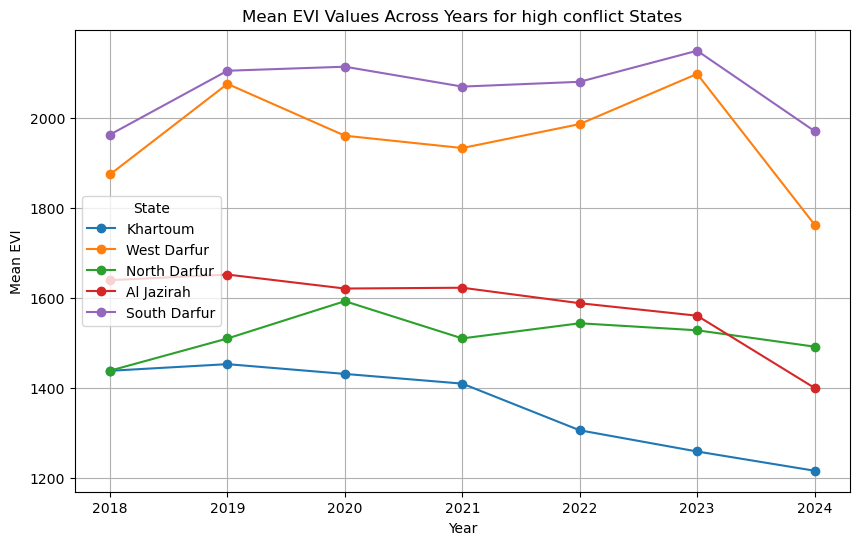

In [32]:
highest_conflict_evi_admin1_df.plot(figsize=(10, 6), marker='o')
plt.xlabel("Year")
plt.ylabel("Mean EVI")
plt.xticks(ticks=highest_conflict_evi_admin1_df.index, labels=[2018,2019, 2020, 2021, 2022, 2023, 2024])
plt.title("Mean EVI Values Across Years for high conflict States")
plt.legend(title='State')
plt.grid(True)
plt.show()

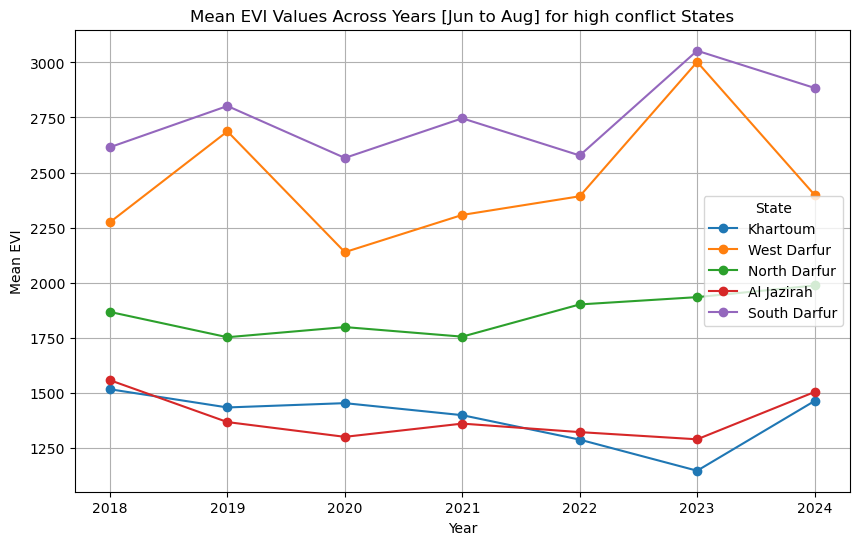

In [47]:
highest_conflict_evi_admin1_gs_df.plot(figsize=(10, 6), marker='o')
plt.xlabel("Year")
plt.ylabel("Mean EVI")
plt.xticks(ticks=highest_conflict_evi_admin1_gs_df.index, labels=[2018,2019, 2020, 2021, 2022, 2023, 2024])
plt.title("Mean EVI Values Across Years [Jun to Aug] for high conflict States")
plt.legend(title='State')
plt.grid(True)
plt.show()

In [ ]:
### Lowest Conflict States

In [44]:
low_n = 5  # Change this to the number of top rows you want
lowest_conflict_admin1 = acled_aggregated.nsmallest(low_n, 'Total_Fatalities')
lowest_conflict_admin1

,State_En,Total_Fatalities,Event_Count
6,Kassala,3,72
11,Red Sea,7,108
5,Gedaref,42,126
10,Northern,46,82
12,River Nile,96,132


In [45]:
lowest_conflict_admin1_list = lowest_conflict_admin1['State_En'].tolist()
lowest_conflict_evi_admin1_df = evi_adm1_yearly[lowest_conflict_admin1_list]
lowest_conflict_evi_admin1_df

,Kassala,Red Sea,Gedaref,Northern,River Nile
0,1516.000320,1369.047667,1585.428585,1415.953311,1645.434854
1,1591.588391,1711.981003,1602.190920,1498.652928,1757.629307
2,1627.808698,1918.084119,1566.029344,1529.907261,1713.695810
3,1482.074839,1646.513821,1642.443975,1490.656616,1724.206982
4,1608.960789,1487.090000,1566.205378,1475.410289,1675.535092
5,1428.414317,1531.201308,1488.795618,1526.578760,1732.684293
6,1355.352873,1405.835802,1216.590523,1572.243035,1757.242095


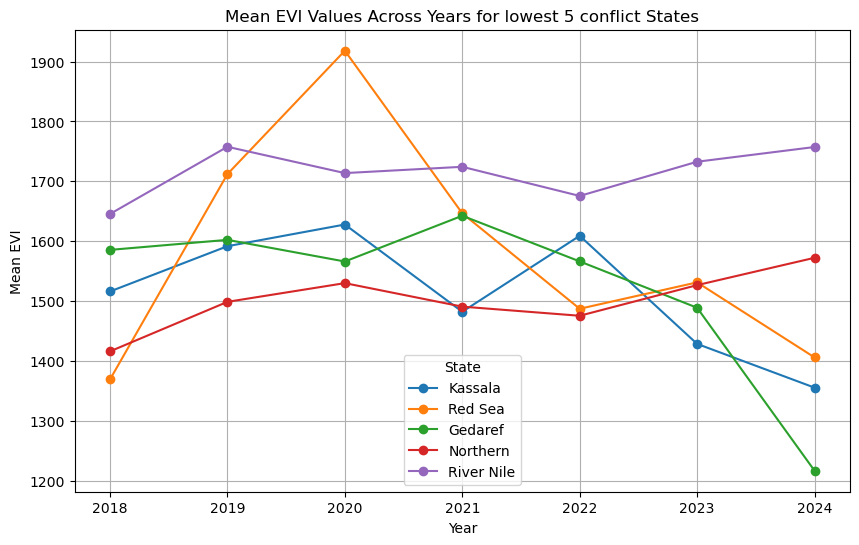

In [41]:
lowest_conflict_evi_admin1_df.plot(figsize=(10, 6), marker='o')
plt.xlabel("Year")
plt.ylabel("Mean EVI")
plt.xticks(ticks=lowest_conflict_evi_admin1_df.index, labels=[2018,2019, 2020, 2021, 2022, 2023, 2024])
plt.title("Mean EVI Values Across Years for lowest 5 conflict States")
plt.legend(title='State')
plt.grid(True)
plt.show()

In [42]:
lowest_conflict_admin1_list = lowest_conflict_admin1['State_En'].tolist()
lowest_conflict_evi_admin1_gs_df = evi_adm1_gs[lowest_conflict_admin1_list]
lowest_conflict_evi_admin1_gs_df

,Kassala,Red Sea,Gedaref,Northern,River Nile
0,1783.099580,1087.566968,1752.694690,1242.693881,1422.688357
1,1583.492654,1277.996705,1623.153999,1319.812809,1468.047860
2,1537.892186,1539.327593,1400.586215,1350.974041,1413.410902
3,1442.156942,1345.656887,1511.701607,1240.886165,1327.539807
4,1652.161023,1203.373894,1525.608789,1235.633214,1325.923418
5,1359.941748,1248.755089,1489.699770,1340.280577,1436.046594
6,1722.159200,1254.514485,1564.571947,1344.720367,1532.768661


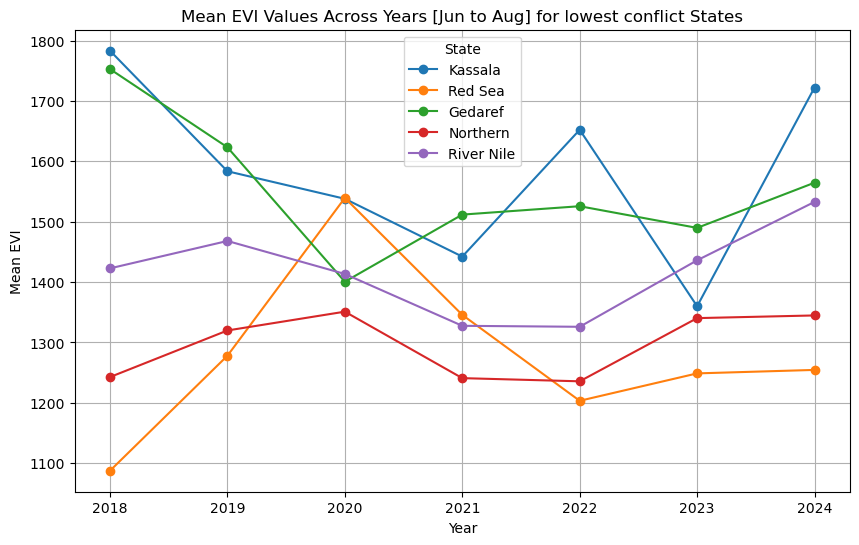

In [46]:
lowest_conflict_evi_admin1_gs_df.plot(figsize=(10, 6), marker='o')
plt.xlabel("Year")
plt.ylabel("Mean EVI")
plt.xticks(ticks=lowest_conflict_evi_admin1_gs_df.index, labels=[2018,2019, 2020, 2021, 2022, 2023, 2024])
plt.title("Mean EVI Values Across Years [Jun to Aug] for lowest conflict States")
plt.legend(title='State')
plt.grid(True)
plt.show()

## No Correlation with Conflict

Conflict, despite its localized severity, does not appear to significantly influence or disrupt agriculture in Sudan. This conclusion is supported by examining the spatial distribution of cropland areas, EVI (Enhanced Vegetation Index) changes, and conflict intensity across the country.

- **Cropland Area Analysis**
   - 21.8% of sudan's cropland area is in high conflict states of Khartoum, West Darfur, North Darfur, Al Jazirah and South Darfur. 

   - 21.5% of Sudan's cropland area is in lowest conflict states of Kassala, Red sea, Gedaref, Northern and River Nile 

   - The spatial distribution of cropland areas reveals no correlation with conflict intensity:

      - High-cropland regions like Gedaref, Sennar, and Gezira are predominantly low-conflict zones, yet high-conflict zones like South Darfur and West Darfur also maintain considerable cropland areas.

      - High-conflict regions like West Darfur and South Darfur retain substantial agricultural activity, with cropland areas totaling 1,548,280 hectares (6.46% of the national total).Despite conflict, these regions show steady or moderate fluctuations in EVI values over time, comparable to low-conflict areas.

- **EVI Change Analysis**
   - The percent change in EVI for high conflict states vs lowest conflict states in 2023 and 2024 in comparison with the EVI average from the past 5 years: 2018 to 2022 doesn't show any correlation with conflict. The correlation statistics also show very low values. 

   - The EVI trends from 2018 to 2024 in high-conflict states (Khartoum, West Darfur, North Darfur, South Darfur, and Al Jazirah) show no dramatic declines, even during the conflict years of 2023 and 2024.
   For example:
      - West Darfur exhibits a recovery in EVI from 2022 to 2024, reaching levels comparable to pre-conflict years.

      - South Darfur maintains a consistently high EVI, indicating healthy vegetation despite conflict intensity.

      - Khartoum shows a modest dip in 2023 but rebounds in 2024.

   - Analysis of EVI changes over time (2019–2024) demonstrates that vegetation dynamics are consistent across both high- and low-conflict areas.
     For example:

      - Gedaref (low-conflict) and South Kordofan (high-conflict) exhibit comparable EVI fluctuations.

   - The temporal fluctuations in EVI across high-conflict states align more with climatic conditions than with conflict. For instance:

      - West Darfur shows a dip in EVI in 2020, a non-conflict year, likely due to climatic factors.

      - South Darfur and Al Jazirah maintain stable or rising EVI trends regardless of conflict onset, reflecting suitable agricultural conditions.

- **ACLED-EVI Overlay**
    - The overlay maps of EVI and conflict events for 2023 and 2024 reveal no spatial overlap between high-conflict areas and zones of declining vegetation.

   - High-conflict regions like North Darfur and South Kordofan show stable or improving EVI values, indicating that agriculture continues unaffected.